# YZTA Datathon 2025

Importing Libraries

In [120]:
from yzta_datathon_2025_eda.utils import load_train, load_test, check_df, concat_df_on_y_axis, create_date_features, create_time_series_features, one_hot_encoder, rare_analyser, grab_col_names, correlation_matrix, high_correlated_cols, plot_importance, hyperparameter_optimization_reg
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.float_format', lambda x: '%.3f' % x)
pd.set_option('display.width', 500)

Loading Datasets

In [3]:
df_train = load_train()
df_test = load_test()

In [5]:
check_df(df_train)

##################### Shape #####################
(227520, 8)
##################### Types #####################
tarih                datetime64[ns]
ürün                         object
ürün besin değeri             int64
ürün kategorisi              object
ürün fiyatı                 float64
ürün üretim yeri             object
market                       object
şehir                        object
dtype: object
##################### Head #####################
       tarih   ürün  ürün besin değeri ürün kategorisi  ürün fiyatı ürün üretim yeri market şehir
0 2019-01-01  kıyma                120              et       32.700         Yurt içi      K     S
1 2019-01-01  tavuk                103              et       11.040         Yurt içi      K     S
2 2019-01-01  hindi                160              et       11.200         Yurt içi      K     S
##################### Tail #####################
            tarih   ürün  ürün besin değeri ürün kategorisi  ürün fiyatı ürün üretim yeri market

In [7]:
check_df(df_test)

##################### Shape #####################
(45504, 8)
##################### Types #####################
id                    int64
tarih                object
ürün                 object
ürün besin değeri     int64
ürün kategorisi      object
ürün üretim yeri     object
market               object
şehir                object
dtype: object
##################### Head #####################
   id       tarih   ürün  ürün besin değeri ürün kategorisi ürün üretim yeri market şehir
0   0  2024-01-01  kıyma                120              et         Yurt içi      K     S
1   1  2024-01-01  tavuk                103              et         Yurt içi      K     S
2   2  2024-01-01  hindi                160              et         Yurt içi      K     S
##################### Tail #####################
          id       tarih   ürün  ürün besin değeri ürün kategorisi ürün üretim yeri market şehir
45501  45501  2024-12-01   kaju                100       kuruyemiş        Yurt dışı      Y     H

Merging Train and Test sets

In [4]:
df_train_test = concat_df_on_y_axis(df_train, df_test)

In [25]:
check_df(df_train_test)

##################### Shape #####################
(273024, 16)
##################### Types #####################
date                datetime64[ns]
product                     object
nutrition                    int64
category                    object
price                      float64
origin                      object
market                      object
city                        object
id                         float64
month                        int32
day_of_year                  int32
year                         int32
quarter                      int32
is_quarter_start             int64
is_year_start                int64
month_number                 int32
dtype: object
##################### Head #####################
        date product  nutrition category  price    origin market city  id  month  day_of_year  year  quarter  is_quarter_start  is_year_start  month_number
0 2019-01-01   kiyma        120       et 32.700  yurt_ici      k    s NaN      1            1  2019        1

Standardizing the column names

In [6]:
df_train_test.columns = df_train_test.columns.str.lower().str.replace(' ', '_').str.strip()

Note: The original Turkish column names are replaced with their English equivalents

'id' -> 'id', 'tarih' -> 'date', 'ürün' -> 'product', 'ürün_besin_değeri' -> 'nutrition', 'ürün_kategorisi' -> 'category', 'ürün_fiyatı' -> 'price', 'ürün_üretim_yeri' -> 'origin', 'market' -> 'market', 'şehir' -> 'city'

In [7]:
df_train_test.rename(columns={
    'id': 'id',
    'tarih': 'date',
    'ürün': 'product',
    'ürün_besin_değeri': 'nutrition',
    'ürün_kategorisi': 'category',
    'ürün_fiyatı': 'price',
    'ürün_üretim_yeri': 'origin',
    'market': 'market',
    'şehir': 'city'
}, inplace=True)

Standardizing the string values in the columns

In [8]:
cols_to_standardize = ['product', 'origin', 'market', 'city', 'category']

for col in cols_to_standardize:
    df_train_test[col] = df_train_test[col].str.lower().str.replace(' ', '_').str.replace('-','_').str.strip()
    df_train_test[col] = df_train_test[col].str.replace('ç', 'c').str.replace('ğ', 'g').str.replace('ı', 'i').str.replace('ö', 'o').str.replace('ş', 's').str.replace('ü', 'u')

In [9]:
df_train_test = create_date_features(df_train_test)

## EDA

In [13]:
df_train_test['month_number'] = ((df_train_test['date'].dt.year - 2019) * 12) + (df_train_test['date'].dt.month - 1)

In [19]:
import statsmodels.api as sm
import statsmodels.formula.api as smf

# Sadece train set üzerinden çalış
df_subset = df_train_test[(df_train_test['date'] >= '2019-01-01') & (df_train_test['date'] <= '2023-12-01')]

# ANOVA: price ~ C(city) + C(market) + C(origin)
model = smf.ols('price ~ C(city) + C(market) + C(origin)', data=df_subset).fit()
anova_table = sm.stats.anova_lm(model, typ=2)
print(anova_table)

                sum_sq         df     F  PR(>F)
C(city)        223.316      7.000 0.152   0.994
C(market)      155.058      2.000 0.370   0.691
C(origin)        5.078      1.000 0.024   0.876
Residual  47641202.589 227509.000   NaN     NaN


In [20]:
df_plot = (
    df_train_test[df_train_test['date'] <= '2023-12-01']  # sadece train dönemi
    .groupby(['product', 'market', 'city', 'month_number'])['price']
    .mean()
    .reset_index()
)

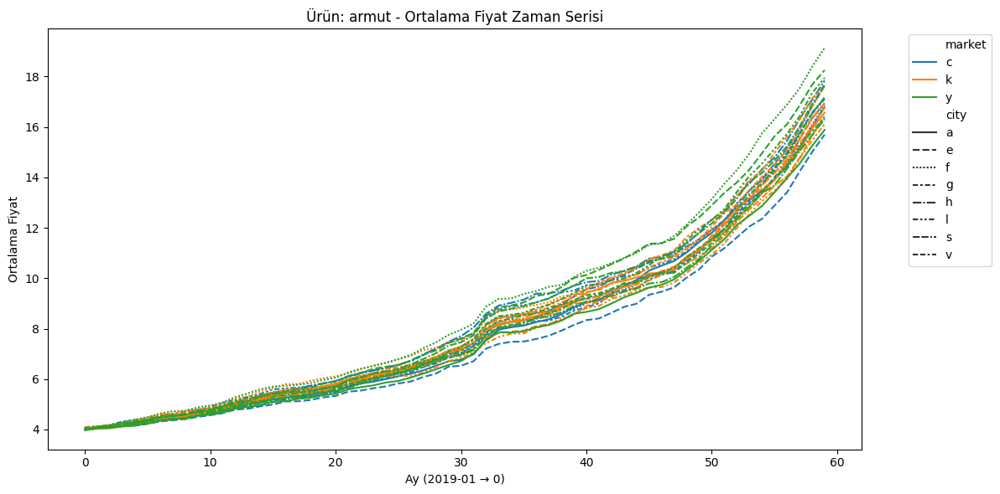

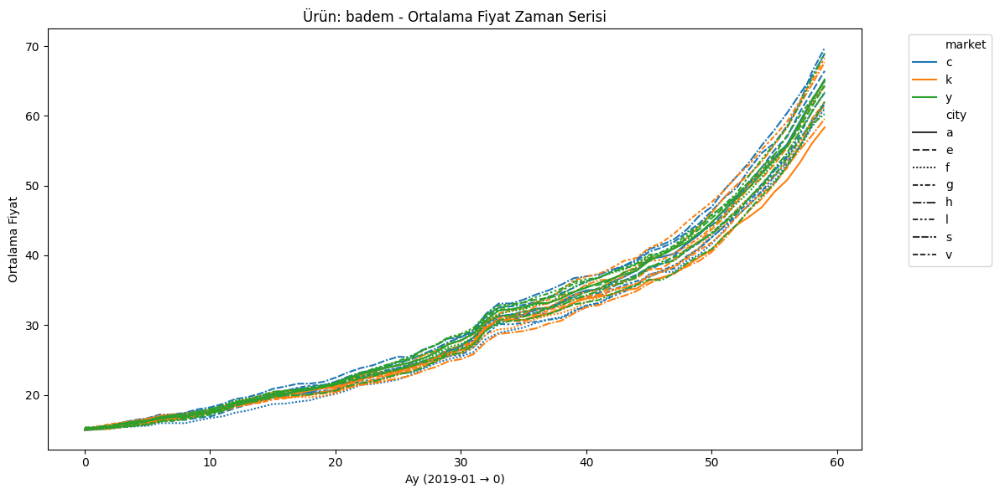

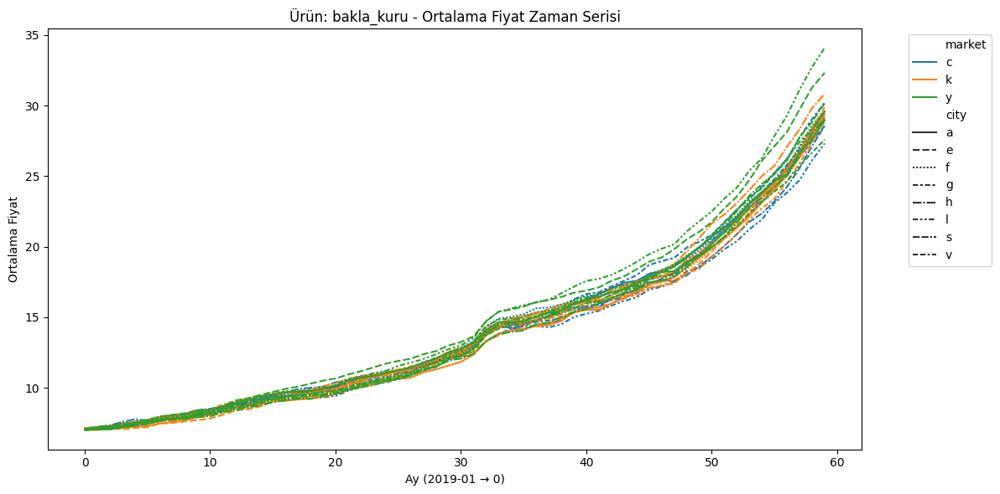

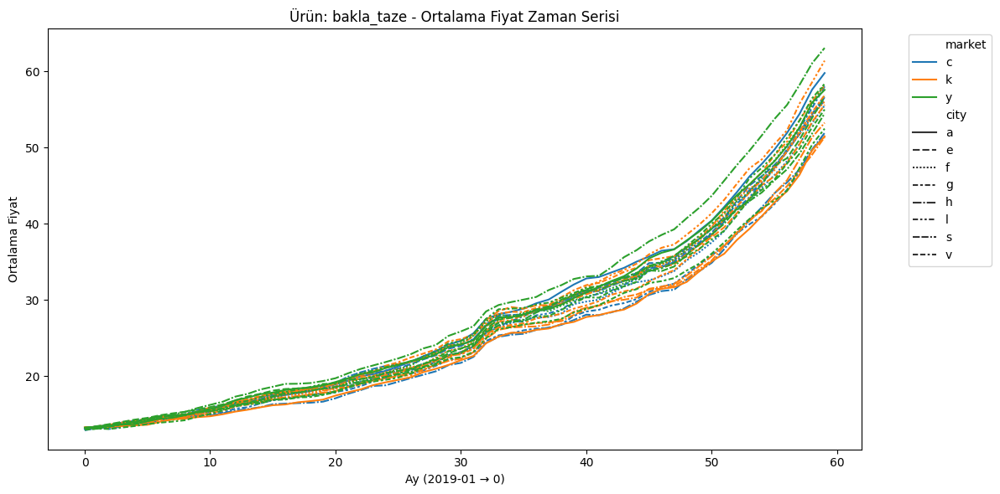

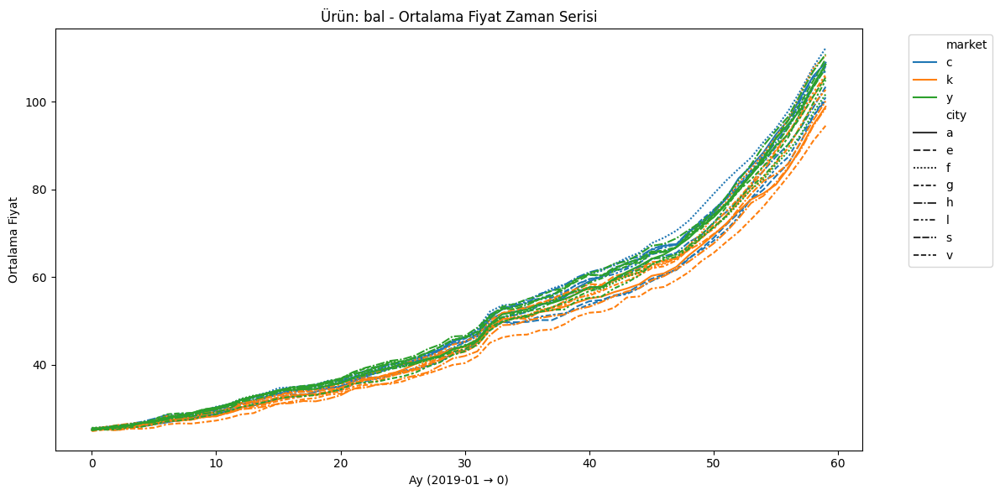

...

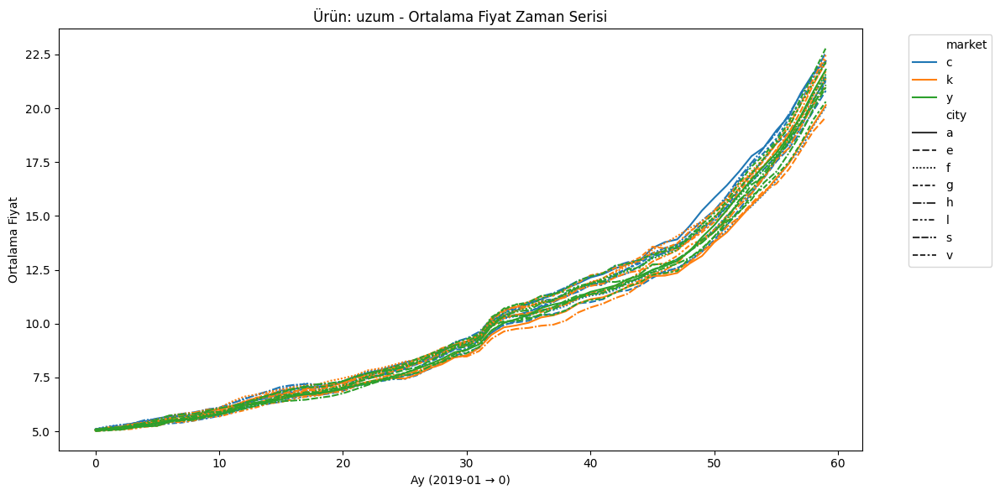

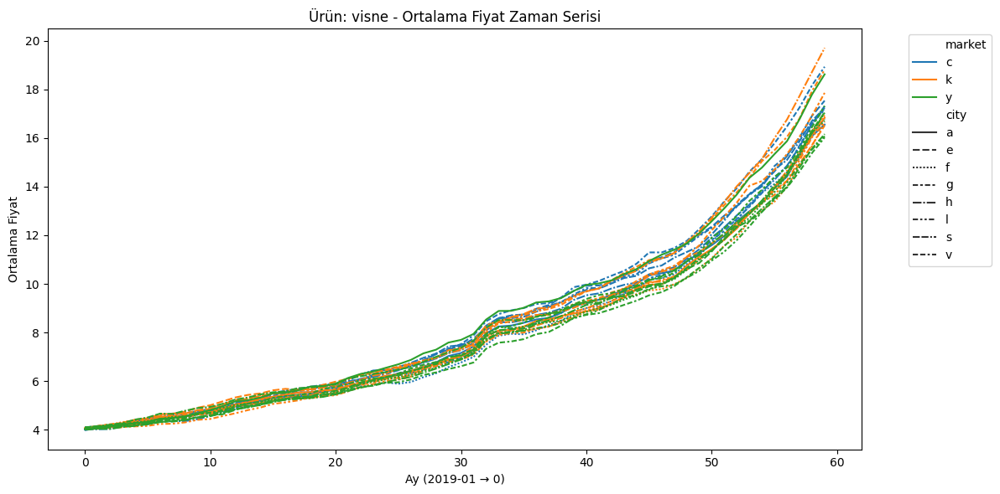

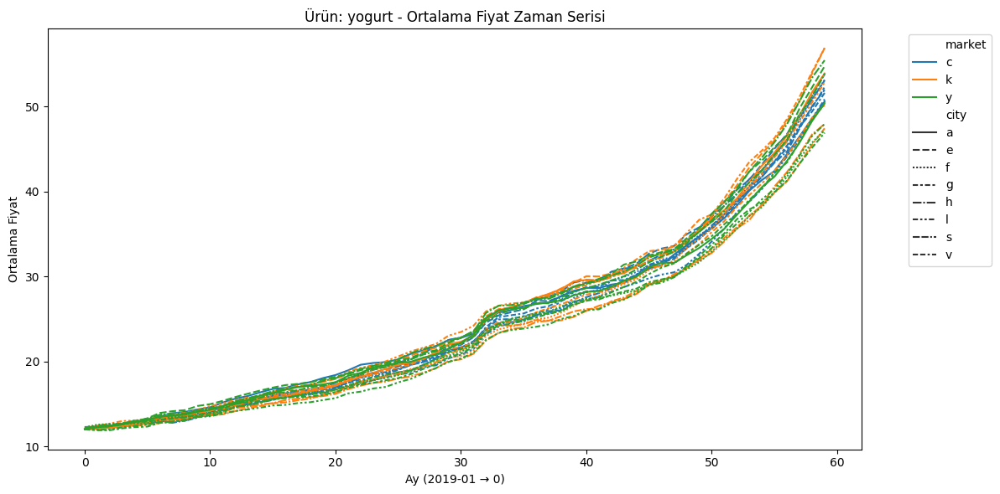

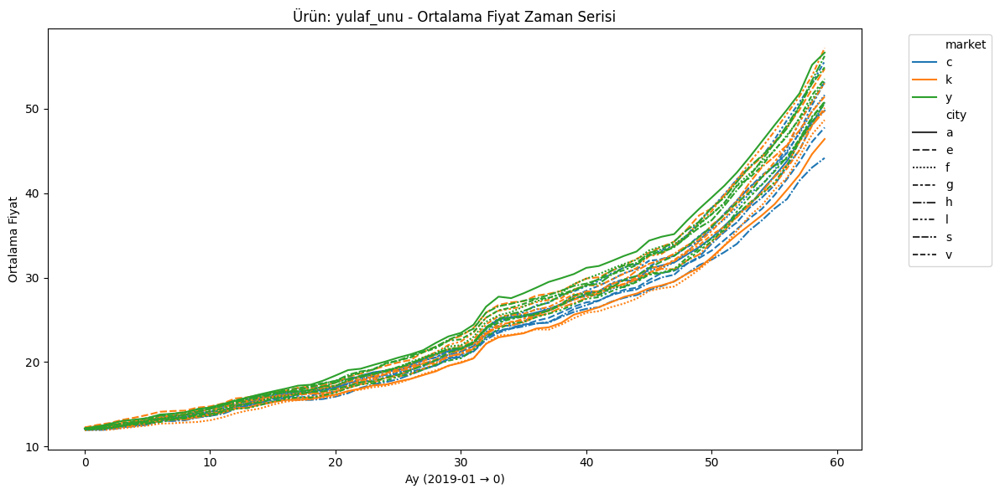

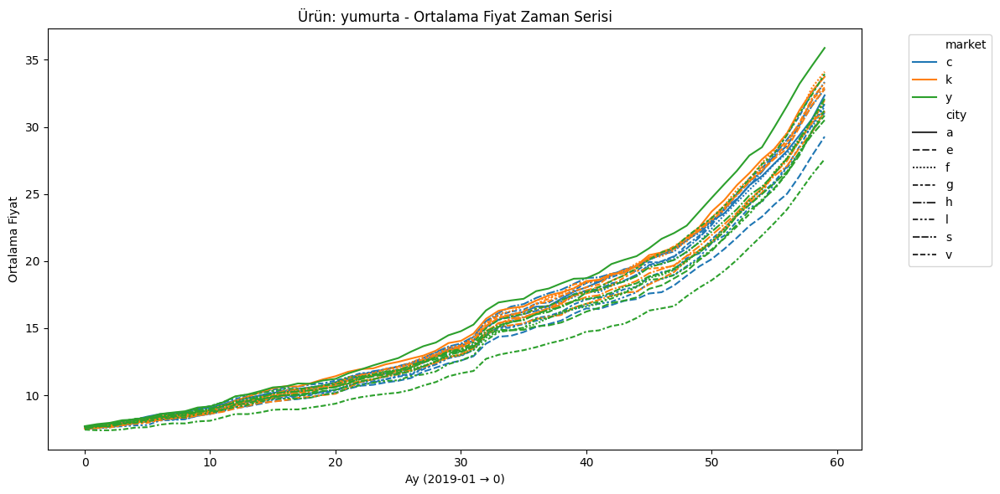

In [23]:
# Ürünleri al
products = df_plot['product'].unique()

for product in products:
    subset = df_plot[df_plot['product'] == product]

    plt.figure(figsize=(12, 6))
    sns.lineplot(
        data=subset,
        x='month_number',
        y='price',
        hue='market',
        style='city',
        markers=False,
        dashes=True
    )
    plt.title(f"Ürün: {product} - Ortalama Fiyat Zaman Serisi")
    plt.xlabel("Ay (2019-01 → 0)")
    plt.ylabel("Ortalama Fiyat")
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

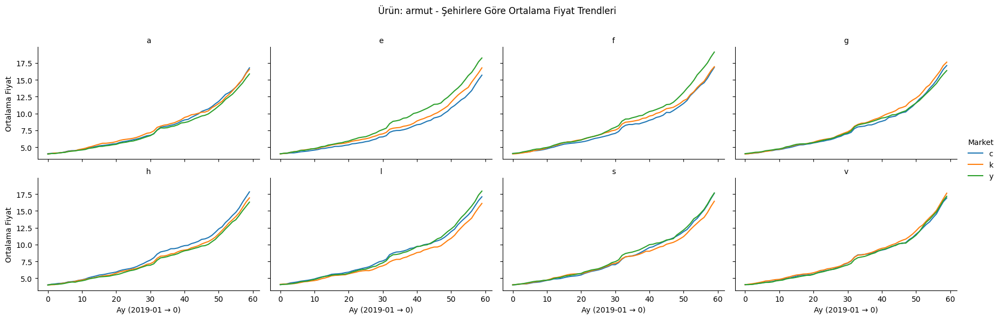

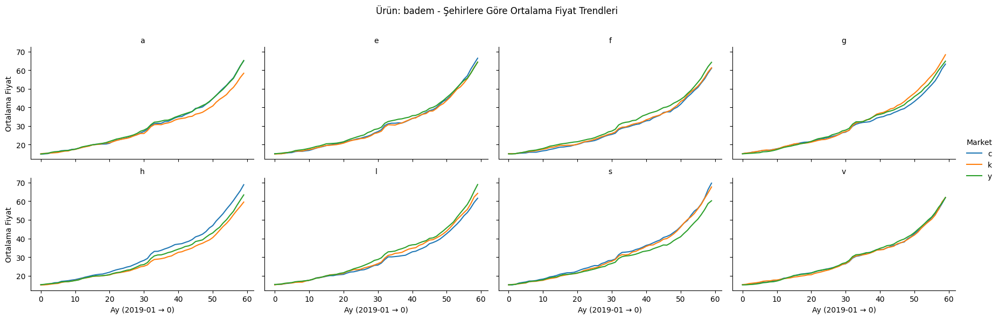

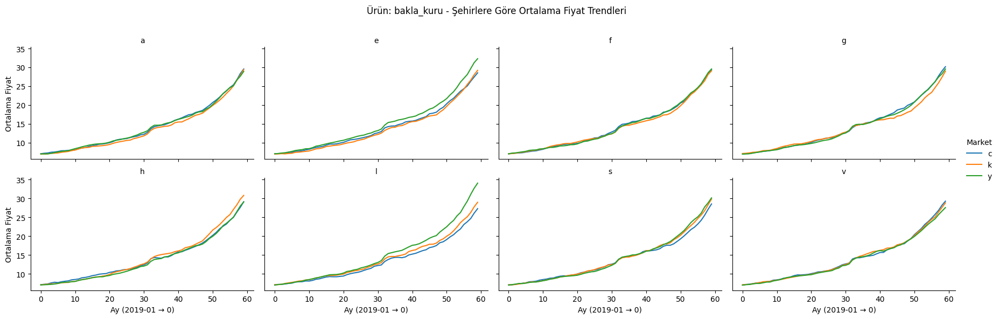

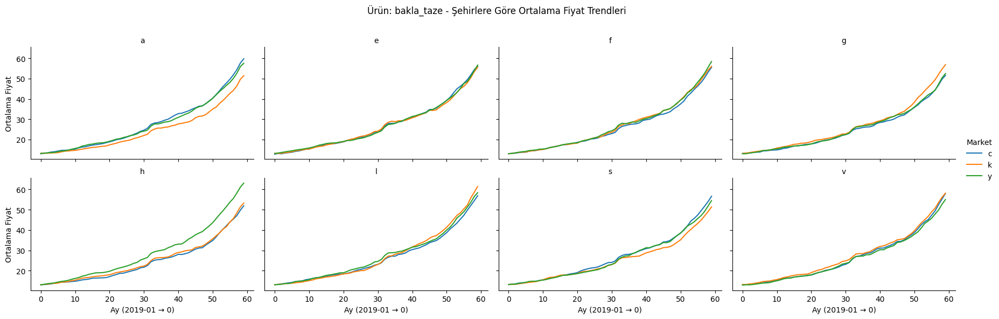

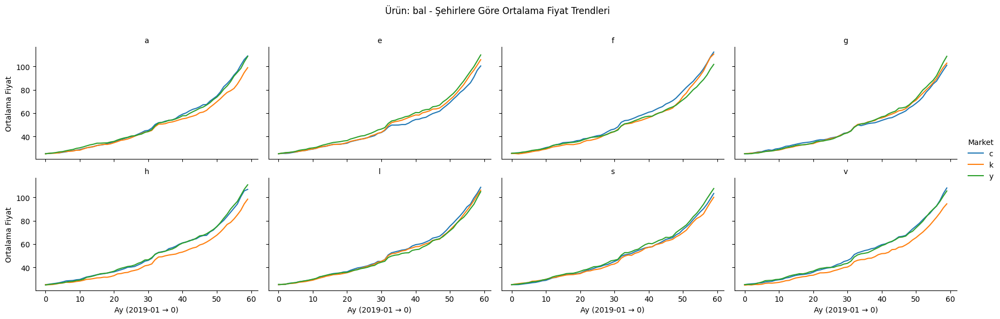

...

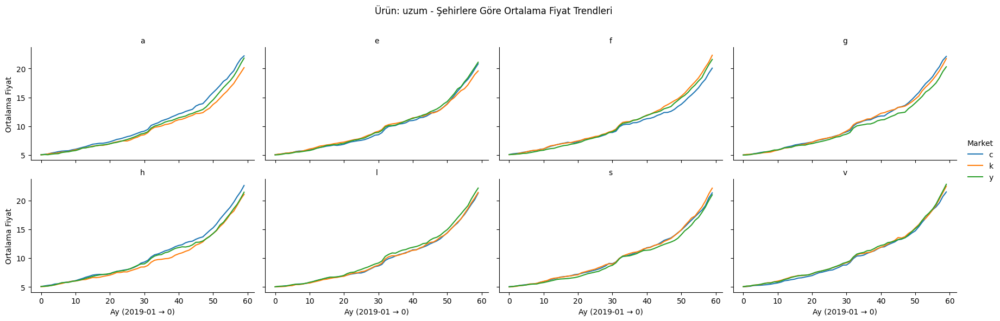

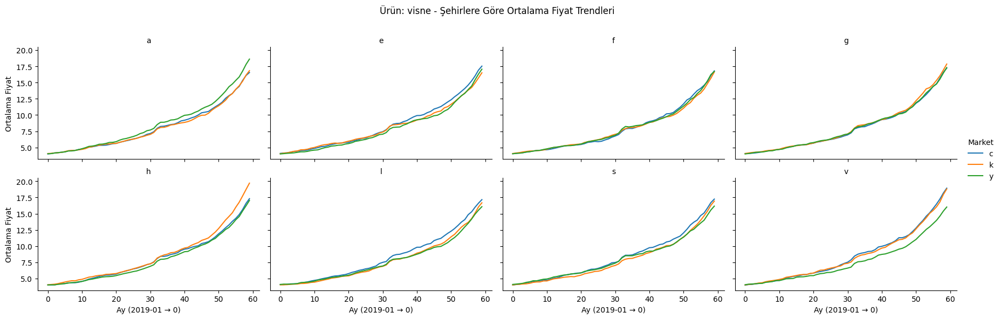

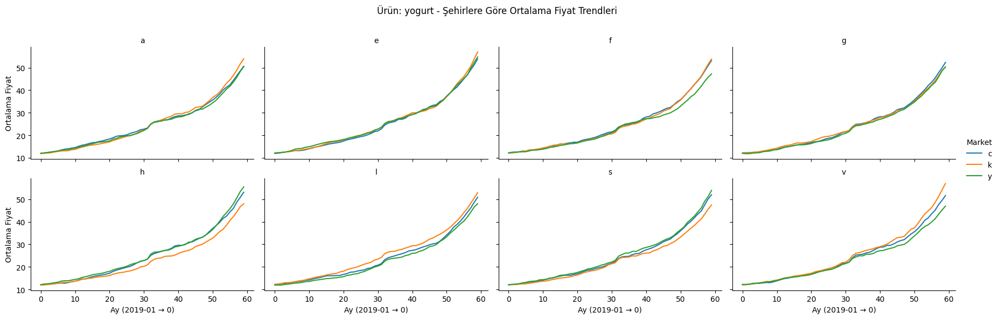

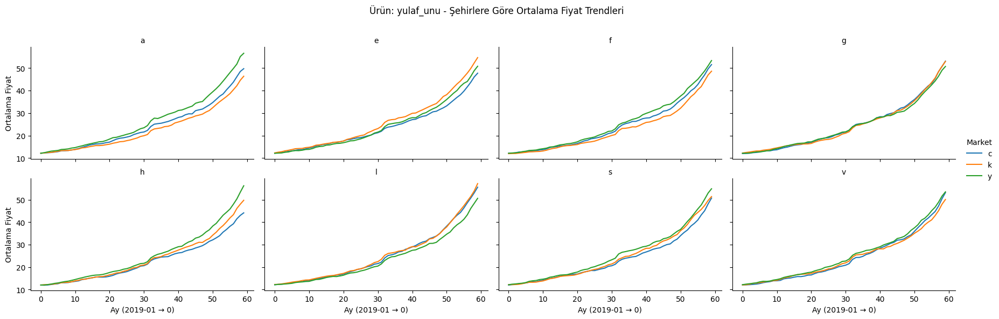

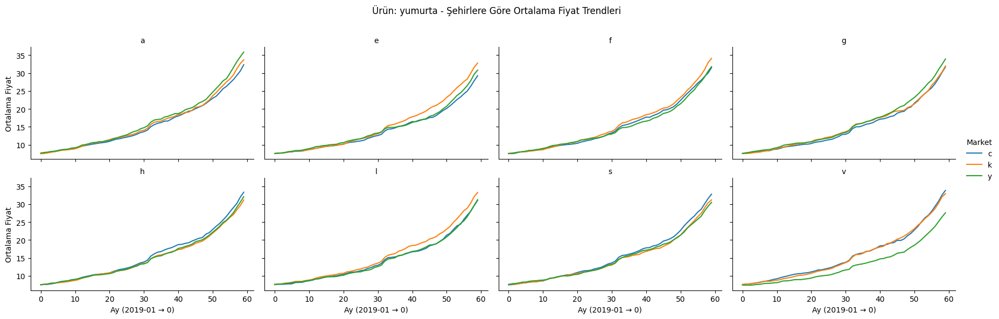

In [24]:
cities = df_plot['city'].unique()

for product in products:
    subset = df_plot[df_plot['product'] == product]

    # 8 subplot (city başına 1 tane)
    g = sns.FacetGrid(
        subset,
        col='city',
        col_wrap=4,
        height=3,
        aspect=1.5,
        sharey=True
    )
    g.map_dataframe(
        sns.lineplot,
        x='month_number',
        y='price',
        hue='market'
    )

    g.set_titles(col_template="{col_name}")
    g.set_axis_labels("Ay (2019-01 → 0)", "Ortalama Fiyat")
    g.add_legend(title='Market')
    plt.subplots_adjust(top=0.85)
    g.fig.suptitle(f"Ürün: {product} - Şehirlere Göre Ortalama Fiyat Trendleri")
    plt.show()

In [66]:
cat_cols, num_cols, cat_but_car = grab_col_names(df_train_test)
print(f"Categorical Columns: {cat_cols}")
print(f"Numerical Columns: {num_cols}")
print(f"Categorical but Cardinal Columns: {cat_but_car}")

Observations: 273024
Variables: 16
cat_cols: 9
num_cols: 6
cat_but_car: 1
num_but_cat: 5
Categorical Columns: ['category', 'origin', 'market', 'city', 'month', 'year', 'quarter', 'is_quarter_start', 'is_year_start']
Numerical Columns: ['date', 'nutrition', 'price', 'id', 'day_of_year', 'month_number']
Categorical but Cardinal Columns: ['product']


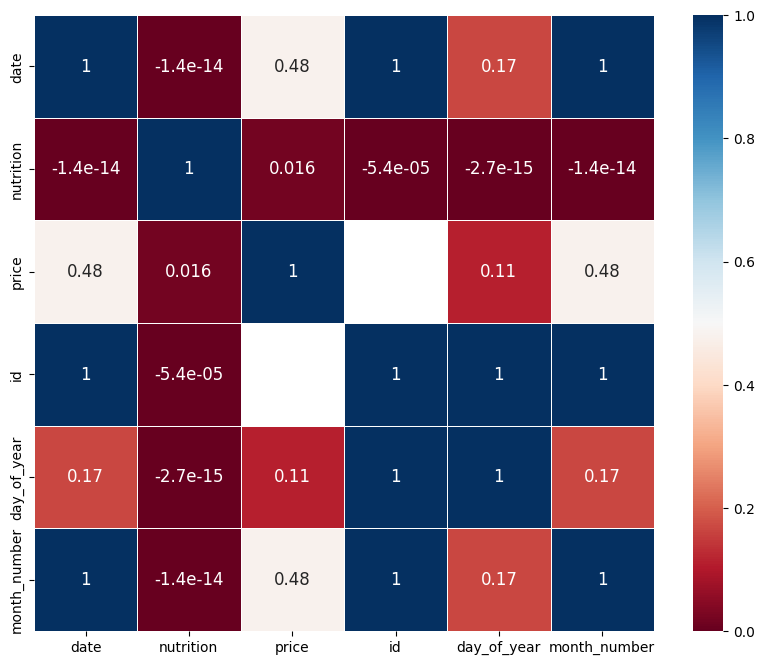

In [68]:
correlation_matrix(df_train_test, num_cols)

### Outlier Detection - Dealing with Outliers

In [ ]:
outliers = []

grouped = df_train_test[df_train_test['date'] <= '2023-12-01'].groupby(
    ['product', 'city', 'month_number']
)

for keys, group in grouped:
    if len(group) < 4:
        continue  # çok küçük gruplarda IQR güvenilmez olur

    q1 = group['price'].quantile(0.25)
    q3 = group['price'].quantile(0.75)
    iqr = q3 - q1
    lower = q1 - 1.5 * iqr
    upper = q3 + 1.5 * iqr

    group_outliers = group[(group['price'] < lower) | (group['price'] > upper)]
    outliers.append(group_outliers)

df_outliers = pd.concat(outliers)

In [31]:
check_df(df_outliers)

##################### Shape #####################
(12583, 16)
##################### Types #####################
date                datetime64[ns]
product                     object
nutrition                    int64
category                    object
price                      float64
origin                      object
market                      object
city                        object
id                         float64
month                        int32
day_of_year                  int32
year                         int32
quarter                      int32
is_quarter_start             int64
is_year_start                int64
month_number                 int32
dtype: object
##################### Head #####################
            date product  nutrition category  price     origin market city  id  month  day_of_year  year  quarter  is_quarter_start  is_year_start  month_number
16804 2019-05-01   armut         57    meyve  4.230   yurt_ici      c    a NaN      5          121  2019

In [43]:
# outlier frequencies
df_outliers.groupby(['origin']).count()
df_outliers.groupby(['city']).count()
df_outliers.groupby(['market']).count()
df_outliers.groupby(['product']).count()

,date,nutrition,category,price,origin,market,city,id,month,day_of_year,year,quarter,is_quarter_start,is_year_start,month_number
product,,,,,,,,,,,,,,,
armut,178,178,178,178,178,178,178,0,178,178,178,178,178,178,178
badem,205,205,205,205,205,205,205,0,205,205,205,205,205,205,205
bakla_kuru,132,132,132,132,132,132,132,0,132,132,132,132,132,132,132
bakla_taze,122,122,122,122,122,122,122,0,122,122,122,122,122,122,122
bal,164,164,164,164,164,164,164,0,164,164,164,164,164,164,164
bamya,165,165,165,165,165,165,165,0,165,165,165,165,165,165,165
barbunya_kuru,179,179,179,179,179,179,179,0,179,179,179,179,179,179,179
beyaz_peynir,236,236,236,236,236,236,236,0,236,236,236,236,236,236,236
bezelye_taze,200,200,200,200,200,200,200,0,200,200,200,200,200,200,200


#### WINSORIZING

In [58]:
group_counts = df_train_test[df_train_test['date'] <= '2023-12-01'] \
    .groupby(['product', 'city', 'month_number']) \
    .size().reset_index(name='count')

group_counts['valid_group'] = group_counts['count'] >= 4

valid_ratio = group_counts['valid_group'].mean()
print(f"Winsorizing uygulanabilen grup oranı: {valid_ratio:.2%}")

Winsorizing uygulanabilen grup oranı: 100.00%


In [60]:
df_winsorized = df_train_test.copy()

grouped = df_winsorized[df_winsorized['date'] <= '2023-12-01'].groupby(['product', 'city', 'month_number'])

for keys, group in grouped:
    idx = group.index
    if len(group) < 4:
        continue

    q1 = group['price'].quantile(0.25)
    q3 = group['price'].quantile(0.75)
    iqr = q3 - q1
    lower = q1 - 1.5 * iqr
    upper = q3 + 1.5 * iqr

    # Winsorizing: Aykırı değerleri baskıla
    df_winsorized.loc[idx, 'price'] = group['price'].clip(lower, upper)

In [122]:
check_df(df_winsorized)

##################### Shape #####################
(273024, 218)
##################### Types #####################
date                                     object
price                                   float64
id                                      float64
month                                     int64
day_of_year                               int64
year                                      int64
quarter                                   int64
is_quarter_start                          int64
is_year_start                             int64
month_number                              int64
price_lag_1                             float64
price_lag_3                             float64
price_lag_6                             float64
price_lag_9                             float64
price_lag_12                            float64
price_lag_24                            float64
price_lag_36                            float64
price_lag_48                            float64
price_rolling_mean_3  

##### Plotting Winsorized Dataframe

In [50]:
df_plot_winsorized = (
    df_winsorized[df_winsorized['date'] <= '2023-12-01']  # sadece train dönemi
    .groupby(['product', 'market', 'city', 'month_number'])['price']
    .mean()
    .reset_index()
)

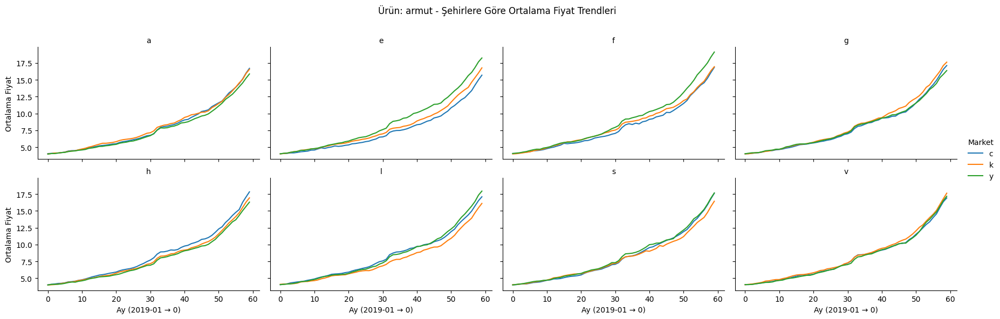

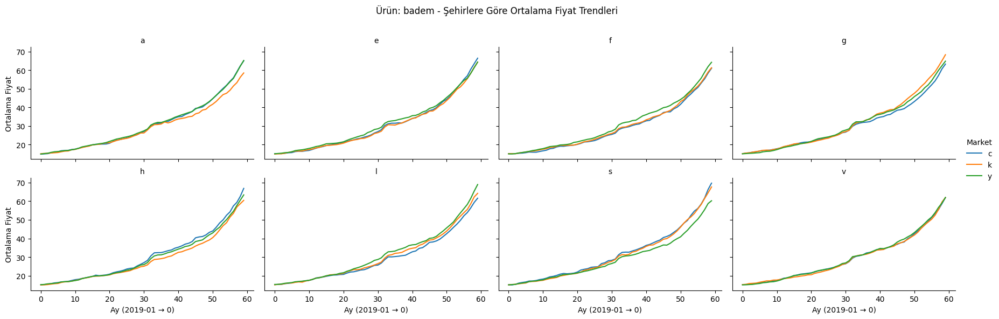

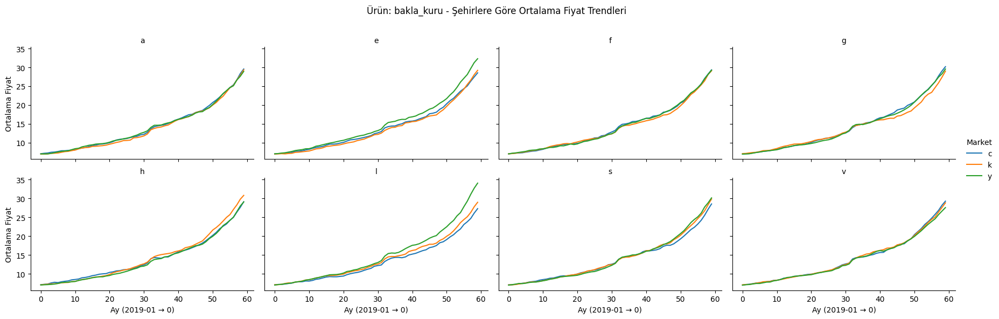

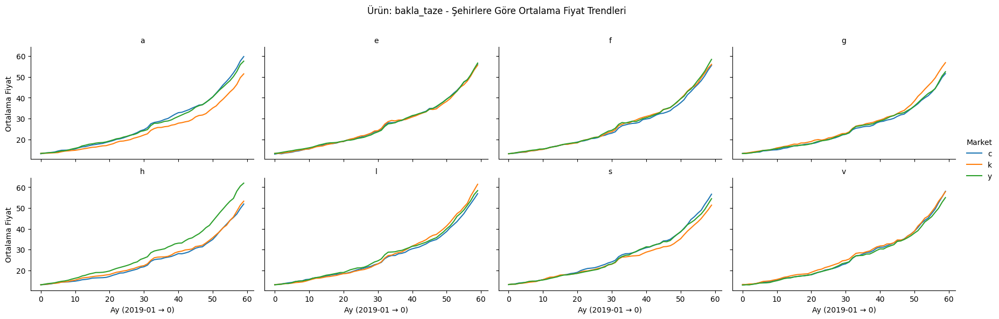

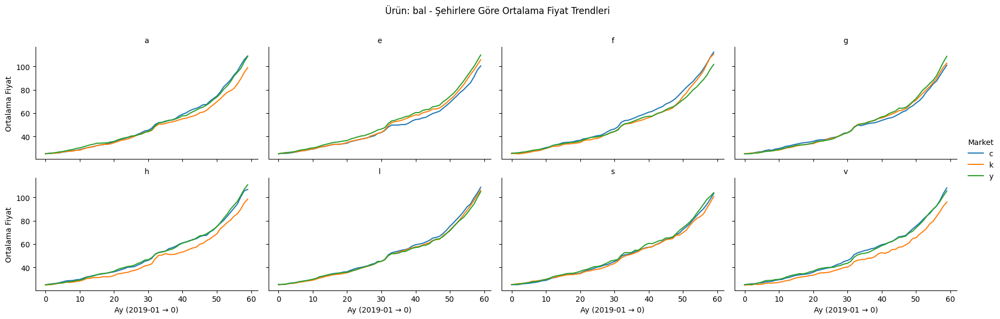

...

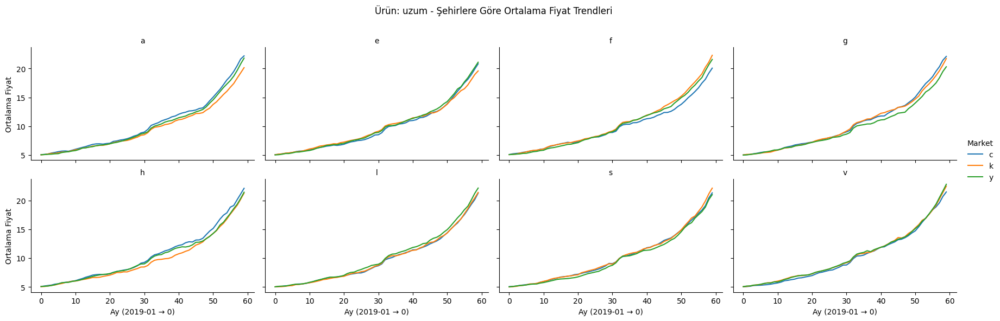

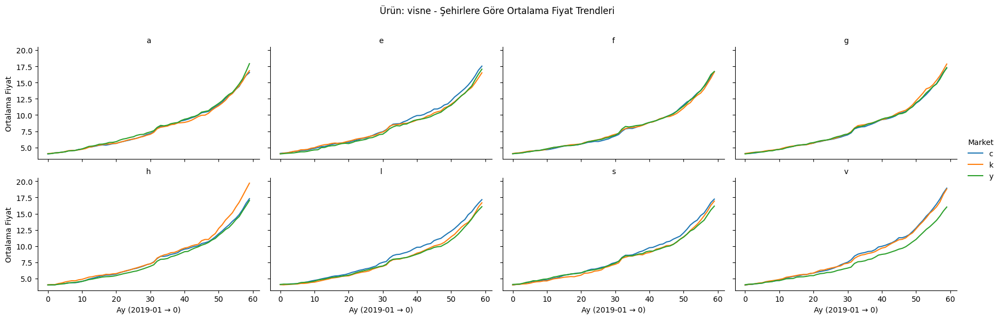

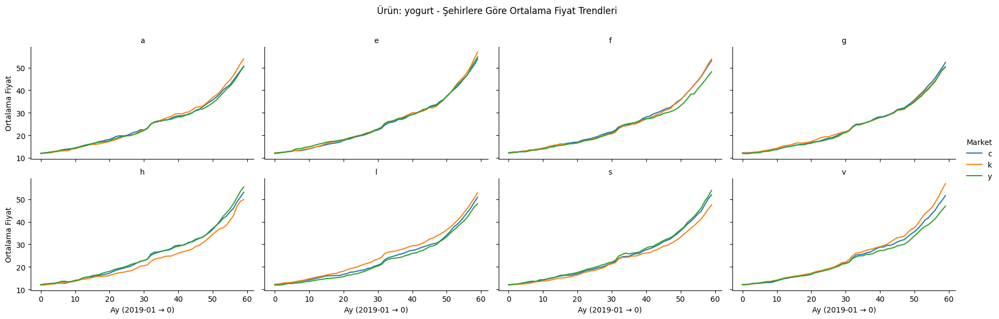

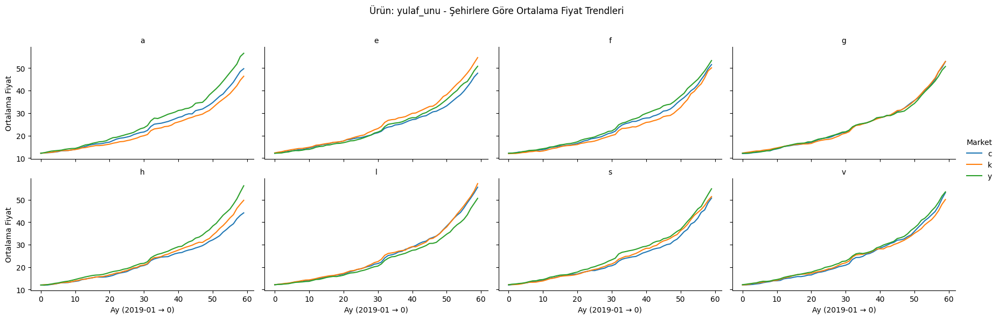

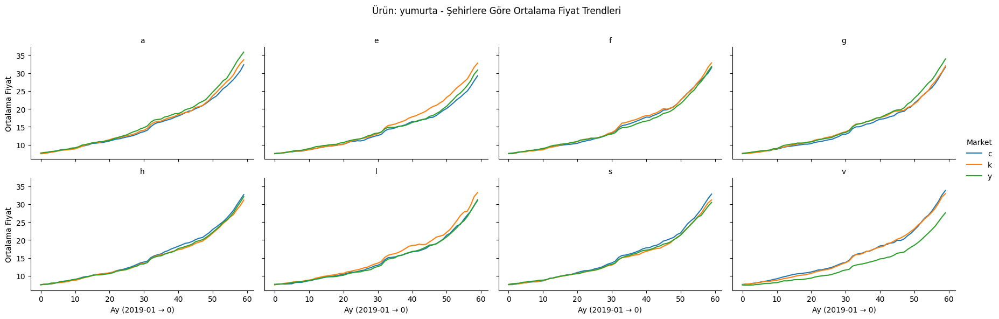

In [51]:
products_winsorized = df_plot_winsorized['product'].unique()

for product in products_winsorized:
    subset = df_plot_winsorized[df_plot_winsorized['product'] == product]

    # 8 subplot (city başına 1 tane)
    g = sns.FacetGrid(
        subset,
        col='city',
        col_wrap=4,
        height=3,
        aspect=1.5,
        sharey=True
    )
    g.map_dataframe(
        sns.lineplot,
        x='month_number',
        y='price',
        hue='market'
    )

    g.set_titles(col_template="{col_name}")
    g.set_axis_labels("Ay (2019-01 → 0)", "Ortalama Fiyat")
    g.add_legend(title='Market')
    plt.subplots_adjust(top=0.85)
    g.fig.suptitle(f"Ürün: {product} - Şehirlere Göre Ortalama Fiyat Trendleri")
    plt.show()

In [52]:
# to_csv
df_winsorized.to_csv('yzta_datathon_2025_eda/data/df_winsorized.csv', index=False)

### Feature Engineering

In [91]:
df_winsorized = pd.read_csv('yzta_datathon_2025_eda/data/df_winsorized.csv')

In [90]:
def random_noise(dataframe):
    """
    This function creates random noise for a time series data.

    Args:
    - dataframe: pandas.DataFrame 
        The dataframe containing the time series data.

    Returns:
    - np.array
        Random noise array.
    """
    return np.random.normal(scale=0.2, size=(len(dataframe),))


def create_lag_features(df, target, lags, breakdown_columns, include_random_noise=False):
    """
    This function creates lag features for a time series data.

    Args:
    - df: pandas.DataFrame
        The dataframe containing the time series data.
    - target: str
        The name of the target column.
    - lags: list
        The list of lag values.
    - breakdown_columns: list
        The list of columns to breakdown the lag features.
    - include_random_noise: bool, default=False
        Whether to add random noise to lag features.

    Returns:
    - df: pandas.DataFrame
        The dataframe with lag features.
    """
    is_breakdown = len(breakdown_columns) > 0

    for lag in lags:
        if is_breakdown:
            df[f"{target}_lag_{lag}"] = df.groupby(breakdown_columns)[target].shift(lag) + (random_noise(df) if include_random_noise else 0)
        else:
            df[f"{target}_lag_{lag}"] = df[target].shift(lag) + (random_noise(df) if include_random_noise else 0)
    return df
    

def create_rolling_features(df, target, windows, breakdown_columns):
    """
    This function creates rolling window features for a time series data.

    Args:
    - df: pandas.DataFrame
        The dataframe containing the time series data.
    - target: str
        The name of the target column.
    - windows: list
        The list of window values.
    - breakdown_columns: list
        The list of columns to breakdown the rolling window features.

    Returns:
    - df: pandas.DataFrame
        The dataframe with rolling window features.
    """
    is_breakdown = len(breakdown_columns) > 0

    for window in windows:
        if is_breakdown:
            df[f"{target}_rolling_mean_{window}"] = df.groupby(breakdown_columns)[target].shift(1).rolling(window=window).mean()
            df[f"{target}_rolling_std_{window}"] = df.groupby(breakdown_columns)[target].shift(1).rolling(window=window).std()
            df[f"{target}_rolling_min_{window}"] = df.groupby(breakdown_columns)[target].shift(1).rolling(window=window).min()
            df[f"{target}_rolling_max_{window}"] = df.groupby(breakdown_columns)[target].shift(1).rolling(window=window).max()
        else:
            df[f"{target}_rolling_mean_{window}"] = df[target].shift(1).rolling(window=window).mean()
            df[f"{target}_rolling_std_{window}"] = df[target].shift(1).rolling(window=window).std()
            df[f"{target}_rolling_min_{window}"] = df[target].shift(1).rolling(window=window).min()
            df[f"{target}_rolling_max_{window}"] = df[target].shift(1).rolling(window=window).max()
    return df

def create_expanding_features(df, target, breakdown_columns):
    """
    This function creates expanding window features for a time series data.

    Args:
    - df: pandas.DataFrame
        The dataframe containing the time series data.
    - target: str
        The name of the target column.
    - breakdown_columns: list
        The list of columns to breakdown the expanding window features.

    Returns:
    - df: pandas.DataFrame
        The dataframe with expanding window features.
    """
    is_breakdown = len(breakdown_columns) > 0

    if is_breakdown:
        df[f"{target}_expanding_mean"] = df.groupby(breakdown_columns)[target].expanding().mean()
        df[f"{target}_expanding_std"] = df.groupby(breakdown_columns)[target].expanding().std()
        df[f"{target}_expanding_min"] = df.groupby(breakdown_columns)[target].expanding().min()
        df[f"{target}_expanding_max"] = df.groupby(breakdown_columns)[target].expanding().max()
    else:
        df[f"{target}_expanding_mean"] = df[target].expanding().mean()
        df[f"{target}_expanding_std"] = df[target].expanding().std()
        df[f"{target}_expanding_min"] = df[target].expanding().min()
        df[f"{target}_expanding_max"] = df[target].expanding().max()
    return df

def ewma_features(df, target, lags, breakdown_columns, alphas = [0.1, 0.3, 0.5, 0.7, 0.9]):
    """
    This function creates exponentially weighted moving average (EWMA) features for a time series data.

    Args:
    - df: pandas.DataFrame
        The dataframe containing the time series data.
    - target: str
        The name of the target column.
    - lags: list
        The list of lag values.
    - breakdown_columns: list
        The list of columns to breakdown the EWMA features.
    - alphas: list, default=[0.1, 0.3, 0.5, 0.7, 0.9]
        The list of alpha values for EWMA.

    Returns:
    - df: pandas.DataFrame
        The dataframe with EWMA features.
    """ 
    is_breakdown = len(breakdown_columns) > 0

    for lag in lags:
        for alpha in alphas:
            if is_breakdown:
                df[f"{target}_ewma_{alpha}_lag_{lag}"] = df.groupby(breakdown_columns)[target].shift(lag).ewm(alpha=alpha).mean()
            else:
                df[f"{target}_ewma_{alpha}_lag_{lag}"] = df[target].shift(lag).ewm(alpha=alpha).mean()
    
    return df

def create_time_series_features(df, target, lags, windows, breakdown_columns = [], include_random_noise = False, alphas = [0.1, 0.3, 0.5, 0.7, 0.9]):
    """
    This function creates time series features for a time series data.

    Args:
    - df: pandas.DataFrame
        The dataframe containing the time series data.
    - target: str
        The name of the target column.
    - lags: list
        The list of lag values.
    - windows: list
        The list of window values.
    - random_noise: bool, default=False
        Whether to add random noise to lag features.
    - alphas: list, default=[0.1, 0.3, 0.5, 0.7, 0.9]
        The list of alpha values for EWMA.

    Returns:
    - df: pandas.DataFrame
        The dataframe with time series features.
    """
    # Create lag features
    df = create_lag_features(df, target, lags, breakdown_columns, include_random_noise=include_random_noise)
    
    # Create rolling window features
    df = create_rolling_features(df, target, windows, breakdown_columns)
    
    # Create expanding window features
    #df = create_expanding_features(df, target, breakdown_columns)
    
    # Create exponentially weighted moving average (EWMA) features
    df = ewma_features(df, target, lags, breakdown_columns, alphas=alphas)

    return df

In [92]:
df_winsorized.sort_values(by=['product', 'origin', 'market', 'city', 'month_number'], inplace=True)

In [93]:
lags = [1, 3, 6, 9, 12, 24, 36, 48]
windows = [3, 6, 9, 12, 24, 36, 48]
breakdowns = ['product', 'origin', 'market', 'city']

df_winsorized = create_time_series_features(
    df=df_winsorized,
    target='price',
    lags=lags,
    windows=windows,
    breakdown_columns=breakdowns,
    include_random_noise=True,
    alphas=[0.3, 0.6, 0.9]
)

### Encoding

Rare Analyzing

In [55]:
columns_to_encode = ['city', 'market', 'product', 'nutrition', 'category', 'origin']

In [56]:
rare_analyser(df_winsorized, 'price', columns_to_encode)

city : 8
      COUNT  RATIO  TARGET_MEAN
city                           
a     34128  0.125       16.982
e     34128  0.125       17.004
f     34128  0.125       16.956
g     34128  0.125       17.051
h     34128  0.125       17.002
l     34128  0.125       17.037
s     34128  0.125       17.045
v     34128  0.125       17.040


market : 3
        COUNT  RATIO  TARGET_MEAN
market                           
c       91008  0.333       17.021
k       91008  0.333       16.982
y       91008  0.333       17.041


product : 79
                  COUNT  RATIO  TARGET_MEAN
product                                    
armut              3456  0.013        8.098
badem              3456  0.013       30.164
bakla_kuru         3456  0.013       14.053
bakla_taze         3456  0.013       26.411
bal                3456  0.013       50.017
bamya              3456  0.013        9.983
barbunya_kuru      3456  0.013       12.051
beyaz_peynir       3456  0.013       30.257
bezelye_taze       3456  0.013   

In [94]:
df_winsorized = one_hot_encoder(df_winsorized, columns_to_encode)

### Feature Importance

In [ ]:
# Feature Importance
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler


train_start = '2019-01-01'
train_end = '2022-12-01'
valid_start = '2023-01-01'
valid_end = '2023-12-01'
test_start = '2024-01-01'
test_end = '2024-12-01'

# Split the data into train, validation, and test sets
df_train_preprocessed = df_winsorized[(df_winsorized['date'] >= train_start) & (df_winsorized['date'] <= train_end)]
df_valid_preprocessed = df_winsorized[(df_winsorized['date'] >= valid_start) & (df_winsorized['date'] <= valid_end)]
df_test_preprocessed = df_winsorized[(df_winsorized['date'] >= test_start) & (df_winsorized['date'] <= test_end)]

cols = [col for col in df_winsorized.columns if col not in ['date', 'id', "price"]]

X_train = df_train_preprocessed[cols]
y_train = df_train_preprocessed["price"]

X_valid = df_valid_preprocessed[cols]
y_valid = df_valid_preprocessed["price"]

X_test = df_test_preprocessed[cols]

X_train.shape, y_train.shape, X_valid.shape, y_valid.shape, X_test.shape

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_valid_scaled = scaler.transform(X_valid)
X_test_scaled = scaler.transform(X_test)

# Train a Random Forest model
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train_scaled, y_train)

# Make predictions
y_train_pred = rf.predict(X_train_scaled)
y_valid_pred = rf.predict(X_valid_scaled)
y_test_pred = rf.predict(X_test_scaled)

# Evaluate the model
train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
valid_rmse = np.sqrt(mean_squared_error(y_valid, y_valid_pred))

train_r2 = r2_score(y_train, y_train_pred)
valid_r2 = r2_score(y_valid, y_valid_pred)

print(f"Train RMSE: {train_rmse:.2f}, R2: {train_r2:.2f}")
print(f"Validation RMSE: {valid_rmse:.2f}, R2: {valid_r2:.2f}")


c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\utils\extmath.py:1101: RuntimeWarning: invalid value encountered in divide
  updated_mean = (last_sum + new_sum) / updated_sample_count
c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\utils\extmath.py:1106: RuntimeWarning: invalid value encountered in divide
  T = new_sum / new_sample_count
c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\utils\extmath.py:1126: RuntimeWarning: invalid value encountered in divide
  new_unnormalized_variance -= correction**2 / new_sample_count


Train RMSE: 0.10, R2: 1.00
Validation RMSE: 2.97, R2: 0.98


AttributeError: 'Index' object has no attribute 'columns'

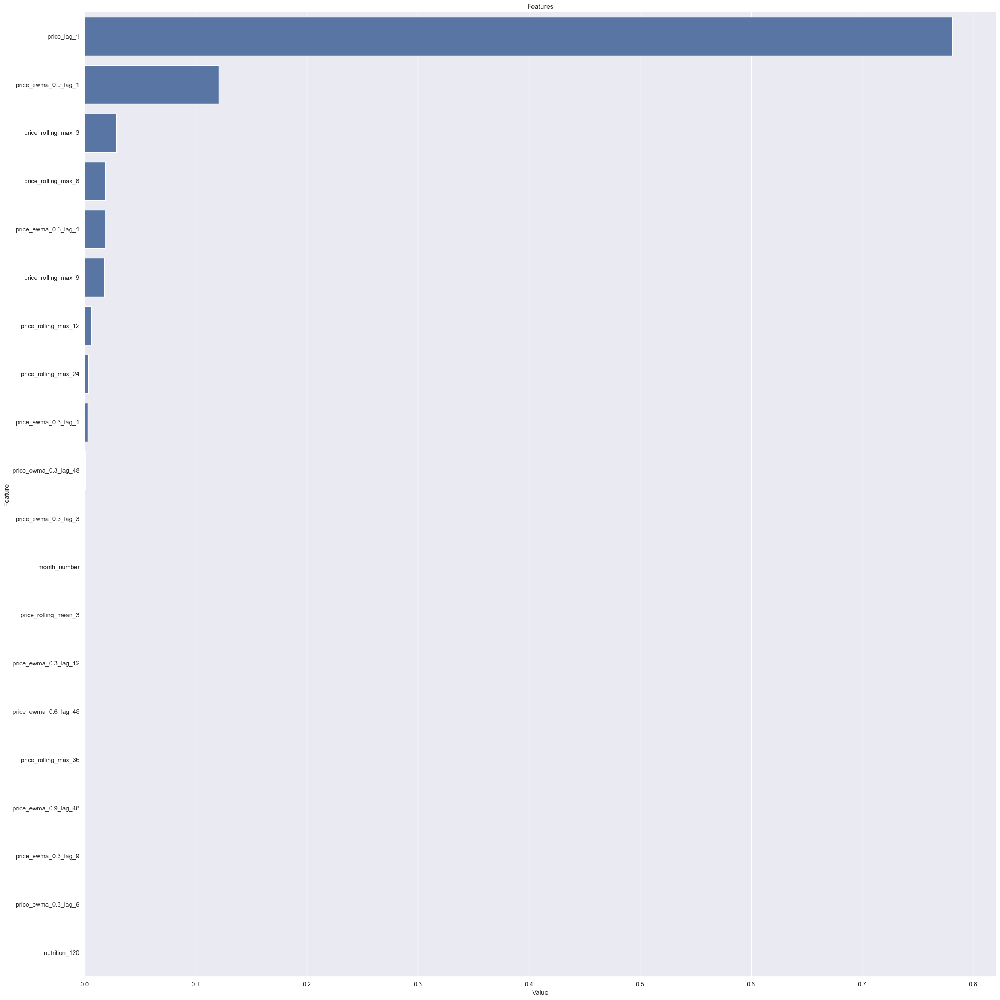

In [ ]:
# Feature Importance
feature_importances = plot_importance(rf, X_train, num=20)

In [118]:
feature_importances.sort_values(by='Value', ascending=False).head(10)

,Value,Feature
7,0.782,price_lag_1
45,0.121,price_ewma_0.9_lag_1
18,0.028,price_rolling_max_3
22,0.019,price_rolling_max_6
44,0.019,price_ewma_0.6_lag_1
26,0.018,price_rolling_max_9
30,0.006,price_rolling_max_12
34,0.003,price_rolling_max_24
43,0.003,price_ewma_0.3_lag_1
64,0.001,price_ewma_0.3_lag_48


In [126]:
# Sorting importances
important_features = feature_importances.sort_values(by='Value', ascending=False)[0:9]['Feature']
important_features = important_features.tolist()
important_features.append('month_number')

## Model Training

In [132]:
df_train_final = df_winsorized.loc[~df_winsorized['price'].isna()]

X_train_final = df_train_final[important_features]
y_train_final = df_train_final["price"]
X_test_final = X_test[important_features]

In [149]:
scaler = StandardScaler()
X_train_final_scaled = pd.DataFrame(data=scaler.fit_transform(X_train_final), columns=important_features)
X_test_final_scaled = pd.DataFrame(data=scaler.transform(X_test_final), columns=important_features)

In [124]:
from sklearn.model_selection import cross_validate, GridSearchCV
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor
import warnings
from sklearn.exceptions import ConvergenceWarning

In [134]:
# Ridge
ridge_params = {
    "alpha": [0.1, 1.0, 10.0, 100.0]
}

# Lasso
lasso_params = {
    "alpha": [0.01, 0.1, 1.0, 10.0]
}

# ElasticNet
elasticnet_params = {
    "alpha": [0.1, 1.0],
    "l1_ratio": [0.3, 0.5, 0.7]
}

# CART
cart_params = {
    "max_depth": [5, 10, 15],
    "min_samples_split": [5, 10],
    "min_samples_leaf": [1, 2]
}

# Random Forest
rf_params = {
    "n_estimators": [100, 200],
    "max_depth": [5, 10],
    "max_features": ["sqrt", None],
    "min_samples_split": [2, 5],
    "min_samples_leaf": [1, 2],
    "n_jobs": [-1]
}

# GBM
gbm_params = {
    "learning_rate": [0.05, 0.1],
    "n_estimators": [100, 200],
    "max_depth": [3, 5],
    "subsample": [0.8, 1.0],
    "min_samples_split": [2, 5]
}

# XGBoost
xgboost_params = {
    "learning_rate": [0.05, 0.1],
    "n_estimators": [100, 200],
    "max_depth": [3, 5],
    "subsample": [0.8, 1.0],
    "colsample_bytree": [0.8, 1.0],
    "gamma": [0, 1],
    "n_jobs": [-1]
}

# LightGBM
lightgbm_params = {
    "learning_rate": [0.05, 0.1],
    "n_estimators": [200, 300],
    "num_leaves": [20, 31],
    "subsample": [0.9, 1.0],
    "colsample_bytree": [0.8, 1.0],
    "n_jobs": [-1]
}

# CatBoost
catboost_params = {
    "depth": [6, 8],
    "learning_rate": [0.05, 0.1],
    "iterations": [200, 300],
    "l2_leaf_reg": [3, 5],
    "thread_count": [-1]
}

regressors = [
    ("Ridge", Ridge(), ridge_params),
    ("Lasso", Lasso(), lasso_params),
    ("ElasticNet", ElasticNet(), elasticnet_params),
    ("CART", DecisionTreeRegressor(), cart_params),
    ("RF", RandomForestRegressor(), rf_params),
    ("GBM", GradientBoostingRegressor(), gbm_params),
    ("XGBoost", XGBRegressor(objective='reg:squarederror'), xgboost_params),
    ("LightGBM", LGBMRegressor(), lightgbm_params),
    ("CatBoost", CatBoostRegressor(verbose=False), catboost_params)
]


def hyperparameter_optimization_reg(X, y, cv=5, scoring="neg_root_mean_squared_error"):
    print("Hyperparameter Optimization....")
    best_models = {}
    for name, regressor, params in regressors:
        print(f"########## {name} ##########")

        try:
            # İlk skor
            cv_results = cross_validate(regressor, X, y, cv=cv, scoring=scoring)
            print(f"{scoring} (Before): {round(-cv_results['test_score'].mean(), 4)}")

            # Grid Search
            gs_best = GridSearchCV(regressor, params, cv=cv, n_jobs=-1, verbose=False).fit(X, y)
            final_model = regressor.set_params(**gs_best.best_params_)

            # Son skor
            cv_results = cross_validate(final_model, X, y, cv=cv, scoring=scoring)
            print(f"{scoring} (After): {round(-cv_results['test_score'].mean(), 4)}")

            print(f"{name} best params: {gs_best.best_params_}\n")
            best_models[name] = final_model

        except Exception as e:
            print(f"{name} FAILED: {str(e)}\n")
    return best_models

In [135]:
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter("ignore", category=ConvergenceWarning)
best_models = hyperparameter_optimization_reg(X_train_final_scaled, y_train_final)

Hyperparameter Optimization....
########## Ridge ##########
Ridge FAILED: 
All the 5 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\model_selection\_validation.py", line 866, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\base.py", line 1389, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\linear_model\_ridge.py", line 1239, in fit
    X, y = validate_data(
  File "c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\utils\validation.py", line 2961, in v

c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003120 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2356
[LightGBM] [Info] Number of data points in the train set: 182016, number of used features: 10
[LightGBM] [Info] Start training from score 16.685699


c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002778 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2356
[LightGBM] [Info] Number of data points in the train set: 182016, number of used features: 10
[LightGBM] [Info] Start training from score 16.847302


c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002763 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2356
[LightGBM] [Info] Number of data points in the train set: 182016, number of used features: 10
[LightGBM] [Info] Start training from score 18.454802


c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000653 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2356
[LightGBM] [Info] Number of data points in the train set: 182016, number of used features: 10
[LightGBM] [Info] Start training from score 17.090977


c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


neg_root_mean_squared_error (Before): 1.1618
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000714 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2356
[LightGBM] [Info] Number of data points in the train set: 227520, number of used features: 10
[LightGBM] [Info] Start training from score 17.014572
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000768 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2356
[LightGBM] [Info] Number of data points in the train set: 182016, number of used features: 10
[LightGBM] [Info] Start training from score 15.994081


c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002790 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2356
[LightGBM] [Info] Number of data points in the train set: 182016, number of used features: 10
[LightGBM] [Info] Start training from score 16.685699


c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000621 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2356
[LightGBM] [Info] Number of data points in the train set: 182016, number of used features: 10
[LightGBM] [Info] Start training from score 16.847302


c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000624 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2356
[LightGBM] [Info] Number of data points in the train set: 182016, number of used features: 10
[LightGBM] [Info] Start training from score 18.454802


c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002931 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2356
[LightGBM] [Info] Number of data points in the train set: 182016, number of used features: 10
[LightGBM] [Info] Start training from score 17.090977


c:\Dev\Repos\YZTA_DATATHON_2025\.venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


neg_root_mean_squared_error (After): 1.1099
LightGBM best params: {'colsample_bytree': 1.0, 'learning_rate': 0.1, 'n_estimators': 300, 'n_jobs': -1, 'num_leaves': 20, 'subsample': 0.9}

########## CatBoost ##########
neg_root_mean_squared_error (Before): 1.1013
neg_root_mean_squared_error (After): 1.1305
CatBoost best params: {'depth': 6, 'iterations': 300, 'l2_leaf_reg': 3, 'learning_rate': 0.05, 'thread_count': -1}



In [150]:
rf_model = best_models['RF']
rf_model.fit(X_train_final_scaled, y_train_final)

RandomForestRegressor(max_depth=10, max_features='sqrt', n_estimators=200,
                      n_jobs=-1)

In [151]:
import joblib
joblib.dump(rf_model, 'rf_model.pkl')

['rf_model.pkl']

In [152]:
test_preds = rf_model.predict(X_test_final_scaled)

In [153]:
########################
# Submission File
########################

submission_df = df_test_preprocessed.loc[:, ["id", "price"]]
submission_df['id'] = submission_df.id.astype(int)

submission_df['price'] = test_preds

submission_df.rename(columns={'price': 'ürün fiyatı'}, inplace=True)

In [154]:
submission_df.sort_values(by=['id'], inplace=True)

In [157]:
submission_df.head()

,id,ürün fiyatı
227520,0,139.425
227521,1,45.335
227522,2,53.264
227523,3,32.391
227524,4,54.460


In [159]:
submission_df.head(10)
#submission_df.tail(10)
submission_df.describe().T

,count,mean,std,min,25%,50%,75%,max
id,45504.000,22751.500,13136.018,0.000,11375.750,22751.500,34127.250,45503.000
ürün fiyatı,45504.000,14.196,11.046,1.737,9.309,11.856,15.177,153.656


In [ ]:
submission_df.to_csv('yzta_datathon_2025_eda/data/rf_model_predictions_submission.csv', index=False)
print("Submission file created successfully!")

Submission file created successfully!
